In [2]:
!pip install scipy
!pip install matplotlib
!pip install seaborn

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
df = pd.read_csv("./dataset.csv")
df

,order_id,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
0,bfbd0f9bdef84302105ad712db648a6c,2016-09-15 12:16:38,1.608160,54.813194,54.813194,44.99,2.83,1000.0,16.0,16.0,16.0,81810,14600,564.407287
1,3b697a20d9e427646d92567910af6d57,2016-10-03 09:44:50,3.000000,19.924525,23.178738,29.90,15.56,300.0,16.0,16.0,16.0,85801,4106,709.921605
2,be5bc2f0da14d8071e2d45451ad119d9,2016-10-03 16:56:50,6.073519,21.094375,24.057500,21.90,17.19,400.0,16.0,16.0,16.0,15802,98280,914.131568
3,a41c8759fbe7aab36ea07e038b2d4465,2016-10-03 21:13:36,8.958426,29.323819,30.572581,36.49,17.24,767.0,26.0,8.0,20.0,18015,90040,816.498486
4,d207cc272675637bfed0062edffd0818,2016-10-03 22:06:03,9.863947,27.027488,27.542813,119.90,13.56,2050.0,40.0,11.0,34.0,14940,13185,212.084845
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92817,52018484704db3661b98ce838612b507,2018-08-29 12:25:59,1.382257,1.425810,1.432269,63.90,9.20,1500.0,28.0,22.0,18.0,5125,5863,18.854775
92818,0b223d92c27432930dfe407c6aea3041,2018-08-29 14:18:23,1.038831,1.079028,1.087870,209.00,46.48,13550.0,48.0,49.0,49.0,82400,80045,10.343719
92819,168626408cb32af0ffaf76711caae1dc,2018-08-29 14:18:28,0.917720,1.098704,1.106979,45.90,15.39,1614.0,31.0,16.0,28.0,30111,38600,431.976676
92820,03ef5dedbe7492bdae72eec50764c43f,2018-08-29 14:52:00,0.858322,1.063623,1.072905,24.90,8.33,450.0,28.0,9.0,19.0,1320,9541,10.312870


### Statistics analysis

- Looking at general metrics we identify that two of the time series have negative values.
- It may sugest the existence of dirty date data.

In [5]:
df.describe()

,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
count,92813.000000,92800.000000,92814.000000,92822.000000,92822.000000,92806.000000,92806.000000,92806.000000,92806.000000,92822.000000,92822.000000,92822.000000
mean,9.368119,12.175228,12.603436,126.631790,20.202209,2107.796263,30.090899,16.532638,22.988406,24706.383067,35177.890177,601.198968
std,8.763700,9.523492,9.553766,192.297625,15.801367,3764.360851,16.107467,13.302656,11.686514,27784.340202,29839.119430,595.644904
min,-5.735984,-6.989653,0.533414,0.850000,0.000000,0.000000,7.000000,2.000000,6.000000,1001.000000,1003.000000,0.000000
25%,4.114213,6.331302,6.790133,42.000000,13.370000,300.000000,18.000000,8.000000,15.000000,6429.000000,11360.000000,184.192126
50%,7.112060,9.883287,10.251453,79.000000,16.370000,700.000000,25.000000,13.000000,20.000000,13520.000000,24418.500000,433.674158
75%,12.057292,15.187491,15.789578,139.900000,21.190000,1813.000000,38.000000,20.000000,30.000000,29260.000000,58897.500000,799.534072
max,205.190972,208.500972,209.628611,6735.000000,409.680000,40425.000000,105.000000,105.000000,118.000000,99730.000000,99980.000000,8711.002674


In [6]:
df[df["time_to_delivery_from_shipment"] <= 0].shape, df[df["time_to_delivery_from_order_approved"] <= 0].shape

((11, 14), (58, 14))

#### 
- We have just a 53 and 63 negative values in each time series, so we just migh as well drop them OR
- We can could replace them
- We can confirm that it is an isolated problem because the mean, std and p50 are very close in between the time_to_delivery columns.

In [7]:
df = df[df["time_to_delivery_from_shipment"] > 0.0]
df = df[df["time_to_delivery_from_order_approved"] > 0.0]
df.describe()


,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
count,92730.000000,92730.000000,92730.000000,92730.000000,92730.000000,92714.000000,92714.000000,92714.000000,92714.000000,92730.000000,92730.000000,92730.000000
mean,9.374169,12.183156,12.607885,126.648386,20.208182,2108.169953,30.090385,16.532929,22.986895,24713.719778,35194.010180,601.539705
std,8.764693,9.519610,9.554428,192.372641,15.806576,3765.166834,16.107850,13.304246,11.686228,27787.892186,29841.280082,595.705569
min,0.000012,0.007662,0.533414,0.850000,0.000000,0.000000,7.000000,2.000000,6.000000,1001.000000,1003.000000,0.000000
25%,4.118174,6.335657,6.794552,42.000000,13.370000,300.000000,18.000000,8.000000,15.000000,6429.000000,11380.000000,184.954409
50%,7.114774,9.886985,10.252795,79.000000,16.370000,700.000000,25.000000,13.000000,20.000000,13560.000000,24426.000000,434.043488
75%,12.060729,15.193009,15.793967,139.900000,21.190000,1813.000000,38.000000,20.000000,30.000000,29300.000000,58977.500000,799.796739
max,205.190972,208.500972,209.628611,6735.000000,409.680000,40425.000000,105.000000,105.000000,118.000000,99730.000000,99980.000000,8711.002674


In [8]:

df[df["freight_value"] == 0]

,order_id,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
20563,2f3a10460f829a155fddd925f0e2f9c5,2017-08-25 10:24:47,7.979329,12.304028,12.311262,195.0,0.0,9750.0,35.0,12.0,30.0,4248,95630,789.400889
20578,34a0606eca141f2c9ccb352883ee3fbe,2017-08-25 11:48:54,3.139352,7.401424,7.412431,195.0,0.0,9750.0,35.0,12.0,30.0,4248,86020,467.552970
20611,d8751e37cdb2166fa6df8a8ebc346768,2017-08-25 15:24:20,14.142755,19.680752,20.139201,164.9,0.0,5950.0,65.0,11.0,65.0,7112,35300,608.359309
20648,ca860fbc7c3132b89e9e134a00652215,2017-08-25 22:08:13,14.177812,14.676400,17.938692,195.0,0.0,9750.0,35.0,12.0,30.0,4248,25075,350.070333
20649,a946d303fa4b1b68eebaf28216e3442a,2017-08-25 22:57:02,6.083241,9.891204,9.900324,195.0,0.0,9750.0,35.0,12.0,30.0,4248,29890,889.067260
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74176,1a2582ca80feaaf937cc94d437ba1635,2018-05-26 07:45:36,12.099410,14.307187,14.330937,69.9,0.0,2600.0,50.0,10.0,30.0,4782,55900,2179.639452
74180,765f62aa9ec878cf62b1533261ae8e87,2018-05-26 08:58:34,14.190104,16.359410,16.370961,69.9,0.0,2600.0,50.0,10.0,30.0,4782,29702,778.587616
74181,32bde441c2a8669167988229bcafe2d7,2018-05-26 09:27:50,19.034641,21.179757,21.195174,69.9,0.0,2600.0,50.0,10.0,30.0,4782,74823,817.426963
92739,9a2176942821e355e4ff9dc4a8e96a07,2018-08-27 16:12:22,1.244907,2.176725,2.184931,89.9,0.0,250.0,22.0,10.0,18.0,9015,8599,29.225810


#### When shipment_distance == 0, it means the seller and the customer are in the same location

In [9]:
df[df["shipment_distance"] == 0]

,order_id,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
337,fc28aed78cb8bcd22a7dbd82cb778946,2017-01-13 15:11:16,4.816181,7.647396,7.657176,498.99,18.60,2650.0,53.0,15.0,13.0,89225,89225,0.0
1633,85b58bb30d219374cf9cfdebbc5fbb69,2017-02-10 09:37:46,0.333079,6.460718,7.344410,59.90,11.81,750.0,25.0,5.0,17.0,14940,14940,0.0
2849,9762ce369c139815a59772bd1efe4496,2017-03-04 17:36:19,4.781181,6.155880,8.605220,39.90,10.96,150.0,20.0,6.0,14.0,17032,17032,0.0
3871,ab8b1138bd32dba20890d59a736b53d2,2017-03-17 12:33:22,2.208681,5.089560,5.089560,50.00,8.72,250.0,16.0,6.0,13.0,90010,90010,0.0
13217,b72eceaf3e014a8336da6b52928715f2,2017-06-26 15:08:20,0.981215,2.328287,2.874850,110.00,48.45,15900.0,40.0,90.0,40.0,83321,83321,0.0
18591,3d7d0dcc28a6dfb5464b9b43e751e45f,2017-08-09 21:42:31,4.039363,5.000440,6.001597,499.99,18.57,3700.0,20.0,38.0,58.0,22240,22240,0.0
24940,dbec6fd4540dcda2662baf24a0bc8f0f,2017-09-27 00:10:07,0.999074,6.821481,6.849051,59.90,12.48,1650.0,30.0,22.0,30.0,15025,15025,0.0
28838,42a64eac09d0a6be5a307753093d45e8,2017-10-25 08:53:51,1.085058,1.416007,1.424572,99.99,12.15,675.0,22.0,24.0,21.0,22240,22240,0.0
34840,6a87a0371f263aa8c1779c2c115c1427,2017-11-25 15:51:01,0.549306,2.858322,2.874097,74.82,8.27,600.0,20.0,10.0,15.0,35570,35570,0.0
43555,f046579c38fc520955aa572d052cbd3c,2018-01-09 00:15:58,4.212535,4.840475,6.960729,34.00,8.27,300.0,30.0,2.0,22.0,59020,59020,0.0


#### Fill empty/zero in Freight values using a freight correios API

In [10]:
!pip install correios-utils

In [11]:
from correios_utils import (
    FormatoEncomenda,
    SimNao,
    Servico,
    realizar_cotacao,
)


def get_freight_by_correios(zip_code_1, zip_code_2, weight, lenght, height, width):
    servicos = realizar_cotacao(
        cep_origem=zip_code_1,
        cep_destino=zip_code_2,
        codigos_servicos=[Servico.PAC, Servico.SEDEX],
        peso=weight,
        comprimento=lenght,
        altura=height,
        largura=width,
        diametro=0,
        formato_encomenda=FormatoEncomenda.CAIXA_PACOTE,
        valor_declarado=0,
        mao_propria=SimNao.NAO,
        aviso_recebimento=SimNao.NAO,
        codigo_empresa="08082650",
        senha_empresa="564321",
    )
    return servicos[0].valor


In [12]:
def format_zip_code(zip_code):
    zip_code = str(zip_code)
    if len(zip_code) == 4:
        return f"0{zip_code}000"
    return f"{zip_code}000"

In [13]:
df["freight_value"] = df.apply(
    lambda row: get_freight_by_correios(
        format_zip_code(row["seller_zip_code_prefix"]),
        format_zip_code(row["customer_zip_code_prefix"]),
        row["product_weight_g"] / 1000,
        row["product_length_cm"],
        row["product_height_cm"],
        row["product_width_cm"]
    ) if row["freight_value"] == 0 else row["freight_value"], axis=1)
df

http://ws.correios.com.br/calculador/CalcPrecoPrazo.aspx?nCdEmpresa=08082650&sDsSenha=564321&sCepOrigem=04248000&sCepDestino=95630000&nVlPeso=9.75&nCdFormato=1&nVlComprimento=35.0&nVlAltura=12.0&nVlLargura=30.0&sCdMaoPropria=N&nVlValorDeclarado=0&sCdAvisoRecebimento=N&nCdServico=04510,04014&nVlDiametro=0&StrRetorno=xml&nIndicaCalculo=3 

http://ws.correios.com.br/calculador/CalcPrecoPrazo.aspx?nCdEmpresa=08082650&sDsSenha=564321&sCepOrigem=04248000&sCepDestino=86020000&nVlPeso=9.75&nCdFormato=1&nVlComprimento=35.0&nVlAltura=12.0&nVlLargura=30.0&sCdMaoPropria=N&nVlValorDeclarado=0&sCdAvisoRecebimento=N&nCdServico=04510,04014&nVlDiametro=0&StrRetorno=xml&nIndicaCalculo=3 

http://ws.correios.com.br/calculador/CalcPrecoPrazo.aspx?nCdEmpresa=08082650&sDsSenha=564321&sCepOrigem=07112000&sCepDestino=35300000&nVlPeso=5.95&nCdFormato=1&nVlComprimento=65.0&nVlAltura=11.0&nVlLargura=65.0&sCdMaoPropria=N&nVlValorDeclarado=0&sCdAvisoRecebimento=N&nCdServico=04510,04014&nVlDiametro=0&StrRetorno=xml

,order_id,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
0,bfbd0f9bdef84302105ad712db648a6c,2016-09-15 12:16:38,1.608160,54.813194,54.813194,44.99,2.83,1000.0,16.0,16.0,16.0,81810,14600,564.407287
1,3b697a20d9e427646d92567910af6d57,2016-10-03 09:44:50,3.000000,19.924525,23.178738,29.90,15.56,300.0,16.0,16.0,16.0,85801,4106,709.921605
2,be5bc2f0da14d8071e2d45451ad119d9,2016-10-03 16:56:50,6.073519,21.094375,24.057500,21.90,17.19,400.0,16.0,16.0,16.0,15802,98280,914.131568
3,a41c8759fbe7aab36ea07e038b2d4465,2016-10-03 21:13:36,8.958426,29.323819,30.572581,36.49,17.24,767.0,26.0,8.0,20.0,18015,90040,816.498486
4,d207cc272675637bfed0062edffd0818,2016-10-03 22:06:03,9.863947,27.027488,27.542813,119.90,13.56,2050.0,40.0,11.0,34.0,14940,13185,212.084845
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92817,52018484704db3661b98ce838612b507,2018-08-29 12:25:59,1.382257,1.425810,1.432269,63.90,9.20,1500.0,28.0,22.0,18.0,5125,5863,18.854775
92818,0b223d92c27432930dfe407c6aea3041,2018-08-29 14:18:23,1.038831,1.079028,1.087870,209.00,46.48,13550.0,48.0,49.0,49.0,82400,80045,10.343719
92819,168626408cb32af0ffaf76711caae1dc,2018-08-29 14:18:28,0.917720,1.098704,1.106979,45.90,15.39,1614.0,31.0,16.0,28.0,30111,38600,431.976676
92820,03ef5dedbe7492bdae72eec50764c43f,2018-08-29 14:52:00,0.858322,1.063623,1.072905,24.90,8.33,450.0,28.0,9.0,19.0,1320,9541,10.312870


In [14]:
df[df["freight_value"] == 0]

,order_id,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
20611,d8751e37cdb2166fa6df8a8ebc346768,2017-08-25 15:24:20,14.142755,19.680752,20.139201,164.9,0.0,5950.0,65.0,11.0,65.0,7112,35300,608.359309
65307,0e5c1cacfc470555872819fae01e07ae,2018-04-16 22:44:14,7.239514,13.708611,13.716273,110.0,0.0,584.0,16.0,11.0,13.0,14050,36570,517.564218
65317,ba9db9fb21617fd062fee898664e4996,2018-04-16 23:22:47,9.440150,14.883843,15.890104,110.0,0.0,584.0,16.0,11.0,13.0,14050,36300,368.769473
65495,e042f1ec6293e2f37caa42cf5878b021,2018-04-17 17:01:58,24.701563,26.799803,26.809005,53.9,0.0,1550.0,30.0,22.0,30.0,15025,47800,1066.599388
65567,2f2bc2963a401290d92ba5b49f52f98f,2018-04-17 23:20:44,15.061852,16.050220,16.060289,112.9,0.0,584.0,16.0,11.0,13.0,14840,75360,508.976916
66089,fb4de3600d359f84927517e78ff9ba54,2018-04-19 22:05:52,13.895312,14.816701,14.823241,69.9,0.0,2600.0,50.0,10.0,30.0,4782,37200,322.558043
66515,4d3fd3b2bf5c3adc542718183a646bac,2018-04-22 15:59:16,21.676574,20.685139,22.812083,69.9,0.0,2600.0,50.0,10.0,30.0,4782,68625,2291.577927
67315,d77c01a7f1b1ea093949dbc6fe3cc2fa,2018-04-25 17:25:13,5.195463,9.713206,9.734201,99.9,0.0,584.0,16.0,11.0,13.0,14050,35300,611.656642
67512,5986af0c84c245048bb86d39d66fe3c1,2018-04-26 13:52:26,5.530475,9.205486,9.219062,99.9,0.0,584.0,16.0,11.0,13.0,14050,33400,444.818223
67619,107f796f9c1e10edb137ba137996d18b,2018-04-26 21:49:13,9.366007,12.708565,12.724190,99.9,0.0,584.0,16.0,11.0,13.0,14050,89700,794.857799


In [15]:
df[df["freight_value"] == 0]["freight_value"].value_counts()

freight_value
0.0    28
Name: count, dtype: int64

In [16]:
df[df["freight_value"] == 0]

,order_id,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
20611,d8751e37cdb2166fa6df8a8ebc346768,2017-08-25 15:24:20,14.142755,19.680752,20.139201,164.9,0.0,5950.0,65.0,11.0,65.0,7112,35300,608.359309
65307,0e5c1cacfc470555872819fae01e07ae,2018-04-16 22:44:14,7.239514,13.708611,13.716273,110.0,0.0,584.0,16.0,11.0,13.0,14050,36570,517.564218
65317,ba9db9fb21617fd062fee898664e4996,2018-04-16 23:22:47,9.440150,14.883843,15.890104,110.0,0.0,584.0,16.0,11.0,13.0,14050,36300,368.769473
65495,e042f1ec6293e2f37caa42cf5878b021,2018-04-17 17:01:58,24.701563,26.799803,26.809005,53.9,0.0,1550.0,30.0,22.0,30.0,15025,47800,1066.599388
65567,2f2bc2963a401290d92ba5b49f52f98f,2018-04-17 23:20:44,15.061852,16.050220,16.060289,112.9,0.0,584.0,16.0,11.0,13.0,14840,75360,508.976916
66089,fb4de3600d359f84927517e78ff9ba54,2018-04-19 22:05:52,13.895312,14.816701,14.823241,69.9,0.0,2600.0,50.0,10.0,30.0,4782,37200,322.558043
66515,4d3fd3b2bf5c3adc542718183a646bac,2018-04-22 15:59:16,21.676574,20.685139,22.812083,69.9,0.0,2600.0,50.0,10.0,30.0,4782,68625,2291.577927
67315,d77c01a7f1b1ea093949dbc6fe3cc2fa,2018-04-25 17:25:13,5.195463,9.713206,9.734201,99.9,0.0,584.0,16.0,11.0,13.0,14050,35300,611.656642
67512,5986af0c84c245048bb86d39d66fe3c1,2018-04-26 13:52:26,5.530475,9.205486,9.219062,99.9,0.0,584.0,16.0,11.0,13.0,14050,33400,444.818223
67619,107f796f9c1e10edb137ba137996d18b,2018-04-26 21:49:13,9.366007,12.708565,12.724190,99.9,0.0,584.0,16.0,11.0,13.0,14050,89700,794.857799


In [17]:
df[df["product_weight_g"] == 0]["product_weight_g"].value_counts()

product_weight_g
0.0    6
Name: count, dtype: int64

In [18]:

df.describe()

,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,customer_zip_code_prefix,shipment_distance
count,92730.000000,92730.000000,92730.000000,92730.000000,92730.000000,92714.000000,92714.000000,92714.000000,92714.000000,92730.000000,92730.000000,92730.000000
mean,9.374169,12.183156,12.607885,126.648386,20.318636,2108.169953,30.090385,16.532929,22.986895,24713.719778,35194.010180,601.539705
std,8.764693,9.519610,9.554428,192.372641,15.805725,3765.166834,16.107850,13.304246,11.686228,27787.892186,29841.280082,595.705569
min,0.000012,0.007662,0.533414,0.850000,0.000000,0.000000,7.000000,2.000000,6.000000,1001.000000,1003.000000,0.000000
25%,4.118174,6.335657,6.794552,42.000000,13.410000,300.000000,18.000000,8.000000,15.000000,6429.000000,11380.000000,184.954409
50%,7.114774,9.886985,10.252795,79.000000,16.430000,700.000000,25.000000,13.000000,20.000000,13560.000000,24426.000000,434.043488
75%,12.060729,15.193009,15.793967,139.900000,21.330000,1813.000000,38.000000,20.000000,30.000000,29300.000000,58977.500000,799.796739
max,205.190972,208.500972,209.628611,6735.000000,409.680000,40425.000000,105.000000,105.000000,118.000000,99730.000000,99980.000000,8711.002674


### Time-series correlation
Method: spearman

Paper: [Ye, Jiaqi, et al. "Time series similarity evaluation based on spearman’s correlation coefficients and distance measures." Cloud Computing and Big Data: Second International Conference, CloudCom-Asia 2015, Huangshan, China, June 17-19, 2015, Revised Selected Papers 2. Springer International Publishing, 2015.](https://link.springer.com/chapter/10.1007/978-3-319-28430-9_24)

In [19]:
columns_to_correlate = ["time_to_delivery_from_shipment", "time_to_delivery_from_order_approved", "time_to_delivery_from_order_purchased", "price", "freight_value", "shipment_distance"]
df_corr = df[columns_to_correlate].corr(method="spearman")
df_corr

,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,price,freight_value,shipment_distance
time_to_delivery_from_shipment,1.000000,0.893514,0.889724,0.097709,0.476507,0.617112
time_to_delivery_from_order_approved,0.893514,1.000000,0.990092,0.112716,0.438225,0.543921
time_to_delivery_from_order_purchased,0.889724,0.990092,1.000000,0.109812,0.438927,0.543563
price,0.097709,0.112716,0.109812,1.000000,0.447243,0.116017
freight_value,0.476507,0.438225,0.438927,0.447243,1.000000,0.659010
shipment_distance,0.617112,0.543921,0.543563,0.116017,0.659010,1.000000


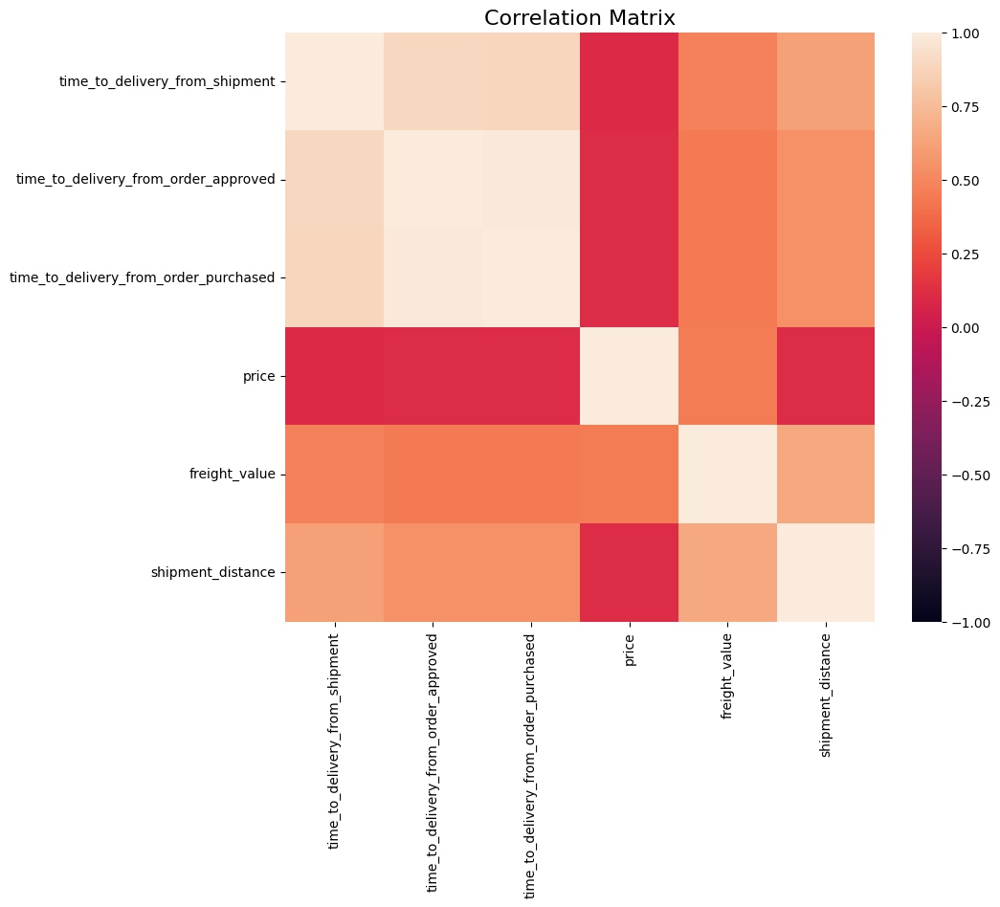

In [20]:
f, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(df_corr,
    vmin=-1.0, vmax=1.0,
    square=True, ax=ax)

plt.title('Correlation Matrix', fontsize=16);


In [21]:
df_final = df[["order_purchase_timestamp", "time_to_delivery_from_shipment", "time_to_delivery_from_order_approved", "time_to_delivery_from_order_purchased", "freight_value", "shipment_distance"]]
df_final

,order_purchase_timestamp,time_to_delivery_from_shipment,time_to_delivery_from_order_approved,time_to_delivery_from_order_purchased,freight_value,shipment_distance
0,2016-09-15 12:16:38,1.608160,54.813194,54.813194,2.83,564.407287
1,2016-10-03 09:44:50,3.000000,19.924525,23.178738,15.56,709.921605
2,2016-10-03 16:56:50,6.073519,21.094375,24.057500,17.19,914.131568
3,2016-10-03 21:13:36,8.958426,29.323819,30.572581,17.24,816.498486
4,2016-10-03 22:06:03,9.863947,27.027488,27.542813,13.56,212.084845
...,...,...,...,...,...,...
92817,2018-08-29 12:25:59,1.382257,1.425810,1.432269,9.20,18.854775
92818,2018-08-29 14:18:23,1.038831,1.079028,1.087870,46.48,10.343719
92819,2018-08-29 14:18:28,0.917720,1.098704,1.106979,15.39,431.976676
92820,2018-08-29 14:52:00,0.858322,1.063623,1.072905,8.33,10.312870


#### Visualization

In [22]:
!pip install plotly
!pip install nbformat

In [23]:
import plotly.express as px

In [24]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92730 entries, 0 to 92821
Data columns (total 6 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   order_purchase_timestamp               92730 non-null  object 
 1   time_to_delivery_from_shipment         92730 non-null  float64
 2   time_to_delivery_from_order_approved   92730 non-null  float64
 3   time_to_delivery_from_order_purchased  92730 non-null  float64
 4   freight_value                          92730 non-null  float64
 5   shipment_distance                      92730 non-null  float64
dtypes: float64(5), object(1)
memory usage: 5.0+ MB


In [25]:
ts_columns = [
    "time_to_delivery_from_order_approved", 
    "time_to_delivery_from_shipment", 
    "time_to_delivery_from_order_purchased",
    "freight_value",
    "shipment_distance"
]

In [29]:
def plot_ts_features(df, ts_columns, prefix):
    import os

    if not os.path.exists("images"):
        os.mkdir("images")
    for col in ts_columns:
        fig = px.line(df, x='order_purchase_timestamp', y=col)
        fig.show()
        fig.write_html(f"./images/{prefix}_{col}.html",
                full_html=False,
                include_plotlyjs='cdn')

In [30]:
plot_ts_features(df_final, ts_columns, "raw_data")

In [28]:
df_final.to_csv("./dataset_final.csv")